# GAN cho tô màu ảnh xám (2)

mô hình 2

## **2. Triển khai**

### 2.1. Cơ sở dữ liệu

#### 2.1.1 Tập dữ liệu COCO

>Cài đặt thư viện 

In [ ]:
# Kết nối với Google Drive từ Colab
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install torchvision==0.10.1

>Cần cài đặt `fastai` để tải xuống một phần tệp dữ liệu `COCO`

In [ ]:
!pip install fastai==2.4

In [ ]:
!pip install torchinfo

In [ ]:
import os
import glob                                       #|hỗ trợ việc tạo danh sách các tập tin từ việc tìm kiếm thư mục dùng ký tự thay thế
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

>Tải xuống khoảng `10.000` hình ảnh từ tập dữ liệu COCO. Lưu ý rằng mình chỉ sử dụng `8000` trong số đó để đào tạo. Ngoài ra, bạn có thể sử dụng bất kỳ tập dữ liệu nào khác như `ImageNet` miễn là nó chứa nhiều `cảnh` và `địa điểm` khác nhau.

In [ ]:
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"
use_colab = True

In [ ]:
if use_colab == True:
    path = coco_path
else:
    path = "Your path to the dataset"
    
paths = glob.glob(path + "/*.jpg") # | Lấy tất cả các tên tệp ảnh
np.random.seed(123)
paths_subset = np.random.choice(paths, 10_000, replace = False) # | Chọn ngẫu nhiên 10000 ảnh
rand_idxs = np.random.permutation(10_000)
train_idxs = rand_idxs[:8000] # | Chọn 8000 ảnh đầu tiên làm tập Huấn luyện
val_idxs = rand_idxs[8000:] # | Chọn 2000 ảnh cuối làm bộ xác thực
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print("Training set: ",len(train_paths),"\nValidation set: ", len(val_paths))

Training set:  8000 
Validation set:  2000


>Hiển thị vài ảnh trong bộ dữ liệu

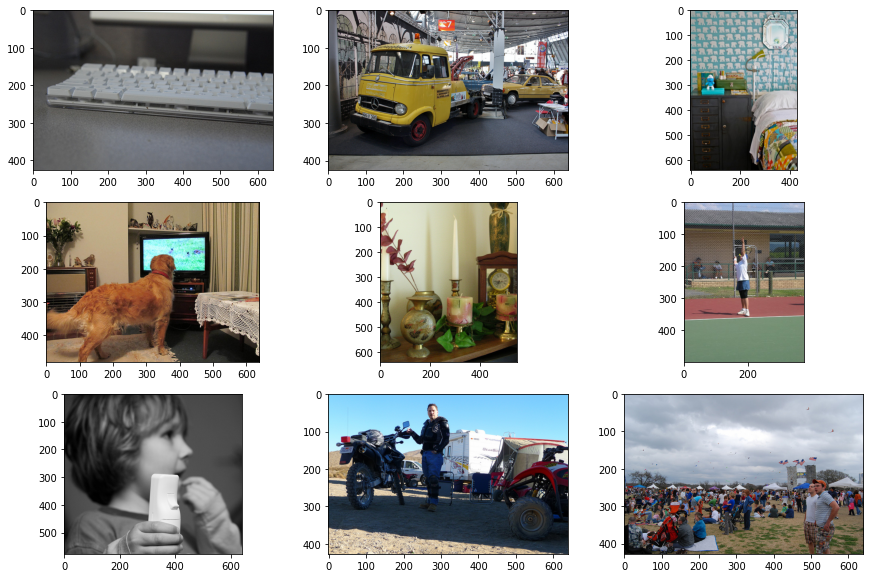

In [ ]:
_, axes = plt.subplots(3, 3, figsize=(15, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    # ax.axis("off")

#### 2.1.2 Tập dữ liệu Landscape

In [ ]:
landscape_path = "/content/drive/MyDrive/landscape Images/color"
paths = glob.glob(landscape_path + "/*.jpg") # | Lấy tất cả các tên tệp ảnh
paths_subset = np.random.choice(paths, 5000, replace = False) # | Chọn ngẫu nhiên 5000 ảnh
rand_idxs = np.random.permutation(5000)
train_idxs = rand_idxs[:4000] # | Chọn 4000 ảnh đầu tiên làm tập Huấn luyện
val_idxs = rand_idxs[4000:] # | Chọn 1000 ảnh cuối làm bộ xác thực
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print("Training set: ",len(train_paths),"\nValidation set: ", len(val_paths))

Training set:  4000 
Validation set:  1000


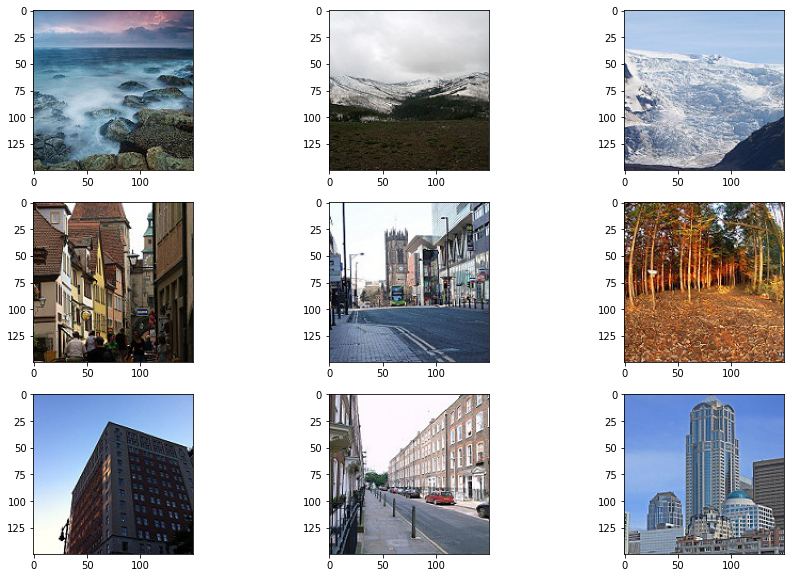

In [ ]:
_, axes = plt.subplots(3, 3, figsize=(15, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))

### 2.2. Xử lý dữ liệu

>Thực hiện thay đổi kích thước của ảnh và lật theo chiều ngang (chỉ lật nếu đó là tập huấn luyện). Sau đó đọc ảnh `RGB`, chuyển đổi nó thành không gian màu `Lab` và tách kênh đầu tiên (thang độ xám) và các kênh màu làm đầu vào. Sau đó tạo bộ tải dữ liệu.

In [ ]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), 
            ])
# | Thay đổi kích thước ảnh về 256 x 256, hàm RandomHorizontalFlip để xoay ngang ảnh 
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)
        
        self.split = split
        self.size = SIZE
        self.paths = paths
    
    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # | Chuyển RGB thành L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab}
    
    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # | Tạo bộ dữ liệu
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [ ]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print("\nKích thước kênh L: ",Ls.shape,"\nKích thước kênh ab: ", abs_.shape)
print("\nlen train_dl: ",len(train_dl),"\nlen val_dl: ", len(val_dl))

### 2.3. Mô hình Generator

>Đào tạo trước riêng generator theo cách có giám sát.

>Lấy cảm hứng từ một ý tưởng trong tài liệu về [Super Resolution](https://arxiv.org/abs/1609.04802), từ đó quyết định đào tạo trước riêng `generator` theo cách có giám sát và xác định để tránh vấn đề hai người không biết dẫn dắt nhau.

>Trên thực tế, sử dụng tiền đào tạo trong hai giai đoạn: 
1.   Xương sống của `generator` (đường dẫn lấy mẫu xuống) là một mô hình được đào tạo trước để phân loại (trên ImageNet)
2.   Toàn bộ `generator` sẽ được đào tạo trước về nhiệm vụ chỉnh màu với mất mát `L1`.

>Sử dụng `ResNet18` được đào tạo trước làm xương sống cho `U-Net` và để hoàn thành giai đoạn thứ hai của quá trình đào tạo trước, đào tạo `U-Net` trên `training` set với chỉ tổn thất `L1`. Sau đó, chúng ta sẽ chuyển sang phần đối đầu và tổn thất L1 kết hợp, như chúng ta đã làm trong phần trước.

>Xây dựng một mạng U-Net với đường trục (backbone) ResNet, mình sẽ sử dụng `Dynamic U-net module` của thư viện `fastai` để dễ dàng xây dựng một mô-đun. Chỉ cần cài đặt fastai bằng pip hoặc conda. [Tài liệu về fastai](https://docs.fast.ai/).

In [ ]:
# !pip install fastai==2.4
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from fastai.vision.models.unet import DynamicUnet

In [ ]:
def build_res_unet(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    body = create_body(resnet18, pretrained=True, n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

### 2.4. Mô hình Discriminator

>Kiến trúc của bộ phân biệt ( discriminator ) này thực hiện một mô hình bằng cách xếp chồng các khối `Conv-BatchNorm-LeackyReLU` để quyết định xem hình ảnh đầu vào là giả hay thật. Lưu ý rằng khối đầu tiên và khối cuối cùng không sử dụng chuẩn hóa và khối cuối cùng không có chức năng kích hoạt (nó được nhúng trong hàm mất mát sẽ sử dụng).

In [ ]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or Đảm bảo rằng không sử dụng chuẩn hoá
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,| Khi cần tạo một số lớp lặp đi lặp lại
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

>Chúng ta hãy xem xét các khối của nó:

>Và hình dạng đầu ra của nó:

In [ ]:
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

In [ ]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

>Ở đây sử dụng `"Patch" Discriminator`. Trong một `vanilla discriminator`, mô hình xuất ra một số (một tỷ lệ) đại diện cho mức độ mà mô hình nghĩ rằng đầu vào (là toàn bộ hình ảnh) là thật (hoặc giả). Trong `patch discriminator`, mô hình xuất ra một số cho mỗi `patch` 70 x 70 pixel của hình ảnh đầu vào và đối với mỗi `patch` sẽ quyết định xem nó có phải là giả hay không một cách `riêng biệt`. Sử dụng một mô hình như vậy cho nhiệm vụ chỉnh màu có vẻ hợp lý đối. Bởi vì những thay đổi cục bộ mà mô hình cần thực hiện thực sự quan trọng và có thể quyết định đến toàn bộ hình ảnh, như trong `vanilla discriminator` không thể quan tâm đến sự tinh tế của nhiệm vụ này. Ở đây, hình dạng đầu ra của mô hình là 30 x 30 nhưng không có nghĩa là các `patch` của chúng ta là 30 x 30. Kích thước `patch` thực tế thu được khi bạn tính toán trường tiếp nhận của mỗi số đầu ra 900 (30 nhân với 30) này trong đó trường hợp của chúng ta sẽ là 70 x 70.


### 2.5. Cấu trúc Mô hình


In [ ]:
# net_G = build_res_unet(n_input=1, n_output=2, size=256)
# print(net_G)

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05

In [ ]:
from torchvision import models
from torchsummary import summary

summary(net_G,(1, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           3,136
       BatchNorm2d-2         [-1, 64, 128, 128]             128
              ReLU-3         [-1, 64, 128, 128]               0
         MaxPool2d-4           [-1, 64, 64, 64]               0
            Conv2d-5           [-1, 64, 64, 64]          36,864
       BatchNorm2d-6           [-1, 64, 64, 64]             128
              ReLU-7           [-1, 64, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          36,864
       BatchNorm2d-9           [-1, 64, 64, 64]             128
             ReLU-10           [-1, 64, 64, 64]               0
       BasicBlock-11           [-1, 64, 64, 64]               0
           Conv2d-12           [-1, 64, 64, 64]          36,864
      BatchNorm2d-13           [-1, 64, 64, 64]             128
             ReLU-14           [-1, 64,

In [ ]:
from torchvision import models
from torchsummary import summary
# net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), device)
# summary(net_D,(3,256,256))
summary(net_D,(3,256,256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           3,136
         LeakyReLU-2         [-1, 64, 128, 128]               0
            Conv2d-3          [-1, 128, 64, 64]         131,072
       BatchNorm2d-4          [-1, 128, 64, 64]             256
         LeakyReLU-5          [-1, 128, 64, 64]               0
            Conv2d-6          [-1, 256, 32, 32]         524,288
       BatchNorm2d-7          [-1, 256, 32, 32]             512
         LeakyReLU-8          [-1, 256, 32, 32]               0
            Conv2d-9          [-1, 512, 31, 31]       2,097,152
      BatchNorm2d-10          [-1, 512, 31, 31]           1,024
        LeakyReLU-11          [-1, 512, 31, 31]               0
           Conv2d-12            [-1, 1, 30, 30]           8,193
Total params: 2,765,633
Trainable params: 2,765,633
Non-trainable params: 0
---------------------------

>Hàm `create_body` tải các trọng số được đào tạo trước của kiến ​​trúc `ResNet18` và cắt mô hình để loại bỏ `hai lớp cuối cùng` (GlobalAveragePooling và một lớp Tuyến tính cho nhiệm vụ phân loại ImageNet). 

>Sau đó, `DynamicUnet` sử dụng xương sống này để xây dựng một `U-Net` với các kênh đầu ra cần thiết (trong trường hợp này là 2 kênh) và với kích thước đầu vào là 256.

In [ ]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds) # mở rộng tensor label với cùng kích thước preds
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [ ]:
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

### 2.6. Hàm mất mát

>Đây là một `class` mà có thể sử dụng để tính toán mất mát GAN của mô hình cuối cùng. Trong `__init__`, loại tổn thất mà sẽ sử dụng (sẽ là `"vanilla"` ) và khai báo một số tensors không đổi làm nhãn `"real"` và `"fake"`. Sau đó, khi chúng ta gọi module này, nó tạo ra một `tensor` thích hợp chứa đầy các số `0` hoặc `1` (theo những gì chúng ta cần ở giai đoạn này) và tính toán tổn thất.

### 2.7. Hoàn chỉnh

>`class` này tập hợp tất cả các phần trước và thực hiện một số phương pháp để đào tạo mô hình hoàn chỉnh.

>Trong `__init__`. Định nghĩa `generator` và `discriminator` bằng cách sử dụng các hàm và `class` trước đó và khởi tạo chúng bằng hàm `init_model`. Sau đó, xác định `hai hàm mất mát` và các `bộ tối ưu hóa` của `generator` và `discriminator`.

>Toàn bộ công việc đang được thực hiện trong phương pháp tối ưu hóa của `class` này. Đầu tiên và chỉ một lần cho mỗi lần lặp (batch của tập huấn luyện), Gọi phương thức chuyển tiếp của module và lưu trữ kết quả đầu ra trong biến `fake_colo` của `class`.

>Sau đó, đầu tiên đào tạo `discriminator` bằng cách sử dụng phương pháp `backward_D` trong đó cung cấp các hình ảnh giả được tạo ra bởi `generator` cho `discriminator` (đảm bảo tách chúng khỏi đồ thị của `generator` để chúng hoạt động như một hằng số đối với `discriminator`, giống như các hình ảnh bình thường) và dán nhãn chúng là hàng `fake`. Tiếp đó, cung cấp một loạt các hình ảnh thực từ tập huấn luyện đến `discriminator` và dán nhãn chúng là `real`. Chúng tôi cộng hai khoản `loss` cho `fake` và `real` và lấy giá trị trung bình, sau đó gọi ngược lại cho khoản `loss` cuối cùng.

>Bây giờ, chúng ta có thể đào tạo `generator`. Trong phương pháp `backward_G`, cung cấp cho `discriminator` hình ảnh `fake` và cố gắng đánh lừa nó bằng cách gán nhãn thực cho chúng và tính toán thiệt hại đối thủ. Như tôi đã đề cập trước đó, chúng tôi cũng sử dụng tổn thất L1 và tính toán khoảng cách giữa hai kênh dự đoán và hai kênh mục tiêu và nhân tổn thất này với một hệ số (trong trường hợp là 100) để cân bằng hai tổn thất và sau đó cộng tổn thất này.

In [ ]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            # Mô hình Generator sẽ được triển khai ở phần dưới
            print("Please load Net_G ...")
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        # xét đề dừng cập nhật trọng số   
        # khi requires_grad = False các trọng số sẽ được đóng băng        
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)  # nối chuỗi kênh L từ data và net_G kênh ab tạo ra ảnh giả
        fake_preds = self.net_D(fake_image.detach())              # tách ảnh giả ra khỏi biểu đồ hiện tại(trả về tensor mới) cho vào net_D 
        self.loss_D_fake = self.GANcriterion(fake_preds, False)   # tính loss của ảnh giả
        real_image = torch.cat([self.L, self.ab], dim=1)          # nối chuỗi ảnh thật
        real_preds = self.net_D(real_image)                       # cho ảnh thật vào net_D
        self.loss_D_real = self.GANcriterion(real_preds, True)    # tính loss của ảnh thật
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5 # tính loss của D
        self.loss_D.backward()                                    # cập nhật 
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)                         # lấy ảnh giả
        fake_preds = self.net_D(fake_image)                                              # cho ảnh giả vào net_D
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)                            # tính loss ảnh giả
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1     # Loss L1 giữa màu giả và kênh ab thật 
        self.loss_G = self.loss_G_GAN + self.loss_G_L1                                   # tính loss G 
        self.loss_G.backward()
    
    def optimize(self):                             # tối ưu hoá
        self.forward()                              # 
        self.net_D.train()                          # 
        self.set_requires_grad(self.net_D, True)    # cập nhâp trọng số bình thường
        self.opt_D.zero_grad()                      # đặt độ dốc về 0 trước khi cập nhật trọng số
        self.backward_D()                           # cập nhật trọng số
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)   # đóng băng các trọng số 
        self.opt_G.zero_grad()                      # 
        self.backward_G()
        self.opt_G.step()

    def validate(self):
        self.forward()
        fake_image = torch.cat([self.L, self.fake_color], dim=1)  # nối chuỗi kênh L từ data và net_G kênh ab tạo ra ảnh giả
        fake_preds = self.net_D(fake_image.detach())              # tách ảnh giả ra khỏi biểu đồ hiện tại(trả về tensor mới) cho vào net_D 
        self.loss_D_fake_val = self.GANcriterion(fake_preds, False)   # tính loss của ảnh giả
        real_image = torch.cat([self.L, self.ab], dim=1)          # nối chuỗi ảnh thật
        real_preds = self.net_D(real_image)                       # cho ảnh thật vào net_D
        self.loss_D_real_val = self.GANcriterion(real_preds, True)   
        self.loss_D_val = (self.loss_D_fake_val + self.loss_D_real_val) * 0.5
        
        fake_image = torch.cat([self.L, self.fake_color], dim=1)                         # lấy ảnh giả
        fake_preds = self.net_D(fake_image)                                              # cho ảnh giả vào net_D
        self.loss_G_GAN_val = self.GANcriterion(fake_preds, True)                            # tính loss ảnh giả
        self.loss_G_L1_val = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1     # Loss L1 giữa màu giả và kênh ab thật 
        self.loss_G_val = self.loss_G_GAN_val + self.loss_G_L1_val                                   # tính loss G 


>Các hàm chức năng

In [ ]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(20, 13))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        # Lưu ảnh
        fig.savefig(f"colorization_{time.time()}.jpg") 
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

def plot_loss_D(loss_meter_dict):
  Loss_Discriminator = []
  for loss_name, loss_meter in loss_meter_dict.items():
    if loss_name == "loss_D" :
      Loss_Discriminator.append(loss_meter.avg)
  return Loss_Discriminator
def plot_loss_G(loss_meter_dict):
  Loss_Generator = []
  for loss_name, loss_meter in loss_meter_dict.items():
    if loss_name == "loss_G" :
      Loss_Generator.append(loss_meter.avg)
  return Loss_Generator 

def save_loss(loss_meter_dict):
  path_file_loss_D_fake = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_D_fake.csv"
  path_file_loss_D_real = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_D_real.csv"
  path_file_loss_D = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_D.csv"
  path_file_loss_G_GAN = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_G_GAN.csv"
  path_file_loss_G_L1 = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_G_L1.csv"
  path_file_loss_G = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_G.csv"

  for loss_name, loss_meter in loss_meter_dict.items():
    if loss_name == "loss_D_fake" :
      file = open (path_file_loss_D_fake,"a")
      file.write(str(loss_meter.avg)+"\n")
      file.close()
    elif loss_name == "loss_D_real" :
      file = open (path_file_loss_D_real,"a")
      file.write(str(loss_meter.avg)+"\n")
      file.close()
    elif loss_name == "loss_D" :
      file = open (path_file_loss_D,"a")
      file.write(str(loss_meter.avg)+"\n")
      file.close()
    elif loss_name == "loss_G_GAN" :
      file = open (path_file_loss_G_GAN,"a")
      file.write(str(loss_meter.avg)+"\n")
      file.close()
    elif loss_name == "loss_G_L1" :
      file = open (path_file_loss_G_L1,"a")
      file.write(str(loss_meter.avg)+"\n")
      file.close()
    elif loss_name == "loss_G" :
      file = open (path_file_loss_G,"a")
      file.write(str(loss_meter.avg)+"\n")
      file.close()
    

### 2.8. Hàm huấn luyện

In [ ]:
def train_model(model, train_dl, epochs, display_every=200):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    Loss_Generator = []
    Loss_Discriminator = []
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs
                save_loss(loss_meter_dict) # lưu loss vào file csv

                Loss_Generator.append(plot_loss_G(loss_meter_dict))
                Loss_Discriminator.append(plot_loss_D(loss_meter_dict))
        # if e % 5 == 0 :
        #   name_save_model = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/final_model_weights_" + str(e+1) + "_epochs.pth"
        #   torch.save(model.state_dict(), name_save_model)
        name_save_model = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Model_14 11/model_weights_" + str(e+1) + "_epochs.pth"
        torch.save(model.state_dict(), name_save_model)
        
    import matplotlib.pyplot as plt
    # %matplotlib inline
    plt.plot(Loss_Generator, 'go-', label='Loss_Generator')
    plt.plot(Loss_Discriminator, 'bo-', label='Loss_Discriminator')
    plt.title('Đồ thị Loss')
    plt.xlabel('Epochs')
    plt.legend(loc='best')
    plt.show()
    



## 3.Huấn luyện trước mô hình Generator

In [ ]:
def pretrain_generator(net_G, train_dl, opt, criterion, epochs):
    L1_loss_resnet18 = []
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            L, ab = data['L'].to(device), data['ab'].to(device)
            preds = net_G(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()
            
            loss_meter.update(loss.item(), L.size(0))
            
        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")
        L1_loss_resnet18.append(loss_meter.avg)
        
    import matplotlib.pyplot as plt
    %matplotlib inline
    plt.plot(L1_loss_resnet18,'ro-')
    plt.show()

>Cần đào tạo trước "res18_unet_epoch_80.pth" và lưu để sử dụng cho `Generator`

In [ ]:
# net_G = build_res_unet(n_input=1, n_output=2, size=256)
# opt = optim.Adam(net_G.parameters(), lr=1e-4)
# criterion = nn.L1Loss()        
# pretrain_generator(net_G, train_dl, opt, criterion, 80)
# torch.save(net_G.state_dict(), "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Resnet18_Unet_pretrain/res18_unet_epoch_80.pth")

>sau khi đào tạo trước resnet18 với 80 epochs (hơn 5h)ta có Loss L1:

![resnet18_80epochs_Loss_1_0.04482](https://i.pinimg.com/564x/73/cc/28/73cc28e32988151519ced1d3c93023db.jpg)


>Đào tạo trước resnet18 cho tập dữ liệu Landscape

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

  0%|          | 0/250 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Epoch 1/80
L1 Loss: 0.08126


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 2/80
L1 Loss: 0.07072


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 3/80
L1 Loss: 0.06876


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 4/80
L1 Loss: 0.06693


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 5/80
L1 Loss: 0.06610


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 6/80
L1 Loss: 0.06472


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 7/80
L1 Loss: 0.06388


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 8/80
L1 Loss: 0.06294


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 9/80
L1 Loss: 0.06232


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 10/80
L1 Loss: 0.06151


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 11/80
L1 Loss: 0.06082


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 12/80
L1 Loss: 0.05948


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 13/80
L1 Loss: 0.05888


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 14/80
L1 Loss: 0.05824


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 15/80
L1 Loss: 0.05735


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 16/80
L1 Loss: 0.05655


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 17/80
L1 Loss: 0.05636


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 18/80
L1 Loss: 0.05556


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 19/80
L1 Loss: 0.05449


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 20/80
L1 Loss: 0.05354


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 21/80
L1 Loss: 0.05334


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 22/80
L1 Loss: 0.05293


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 23/80
L1 Loss: 0.05269


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 24/80
L1 Loss: 0.05164


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 25/80
L1 Loss: 0.05126


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 26/80
L1 Loss: 0.05101


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 27/80
L1 Loss: 0.05041


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 28/80
L1 Loss: 0.04986


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 29/80
L1 Loss: 0.04990


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 30/80
L1 Loss: 0.04955


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 31/80
L1 Loss: 0.04858


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 32/80
L1 Loss: 0.04773


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 33/80
L1 Loss: 0.04704


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 34/80
L1 Loss: 0.04664


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 35/80
L1 Loss: 0.04618


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 36/80
L1 Loss: 0.04585


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 37/80
L1 Loss: 0.04539


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 38/80
L1 Loss: 0.04466


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 39/80
L1 Loss: 0.04438


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 40/80
L1 Loss: 0.04383


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 41/80
L1 Loss: 0.04368


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 42/80
L1 Loss: 0.04390


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 43/80
L1 Loss: 0.04309


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 44/80
L1 Loss: 0.04241


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 45/80
L1 Loss: 0.04223


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 46/80
L1 Loss: 0.04173


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 47/80
L1 Loss: 0.04091


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 48/80
L1 Loss: 0.04030


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 49/80
L1 Loss: 0.03998


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 50/80
L1 Loss: 0.03997


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 51/80
L1 Loss: 0.03999


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 52/80
L1 Loss: 0.03970


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 53/80
L1 Loss: 0.03938


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 54/80
L1 Loss: 0.03937


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 55/80
L1 Loss: 0.03895


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 56/80
L1 Loss: 0.03787


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 57/80
L1 Loss: 0.03701


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 58/80
L1 Loss: 0.03660


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 59/80
L1 Loss: 0.03655


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 60/80
L1 Loss: 0.03662


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 61/80
L1 Loss: 0.03643


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 62/80
L1 Loss: 0.03614


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 63/80
L1 Loss: 0.03589


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 64/80
L1 Loss: 0.03569


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 65/80
L1 Loss: 0.03548


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 66/80
L1 Loss: 0.03530


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 67/80
L1 Loss: 0.03487


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 68/80
L1 Loss: 0.03428


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 69/80
L1 Loss: 0.03389


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 70/80
L1 Loss: 0.03372


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 71/80
L1 Loss: 0.03375


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 72/80
L1 Loss: 0.03384


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 73/80
L1 Loss: 0.03395


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 74/80
L1 Loss: 0.03384


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 75/80
L1 Loss: 0.03344


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 76/80
L1 Loss: 0.03334


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 77/80
L1 Loss: 0.03333


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 78/80
L1 Loss: 0.03348


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 79/80
L1 Loss: 0.03287


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch 80/80
L1 Loss: 0.03220


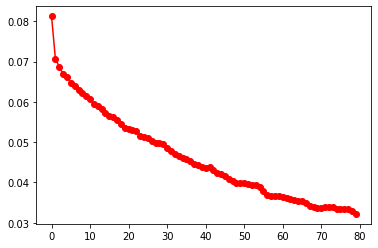

FileNotFoundError: ignored

In [ ]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)
opt = optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()        
pretrain_generator(net_G, train_dl, opt, criterion, 80)
torch.save(net_G.state_dict(), "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Resnet18_Unet_pretrain/res18_unet_epoch_80_landscape.pth")

## 4. Quá trình Training

In [ ]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)  # xây dựng mô hình unet 
net_G.load_state_dict(torch.load("/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Resnet18_Unet_pretrain/res18_unet_epoch_80.pth", map_location=device)) # load mô hình
model = MainModel(net_G=net_G)
train_model(model, train_dl, 100)
torch.save(model.state_dict(), "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/final_model_weights_100.pth")

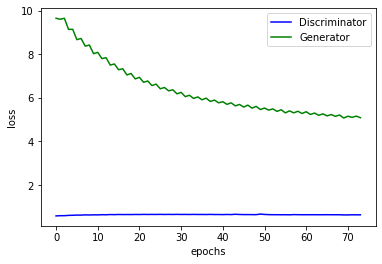

In [ ]:
import pandas as pd

path_file_loss_D_fake = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_D_fake.csv"
path_file_loss_D_real = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_D_real.csv"
path_file_loss_D = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_D.csv"
path_file_loss_G_GAN = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_G_GAN.csv"
path_file_loss_G_L1 = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_G_L1.csv"
path_file_loss_G = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Loss/loss_G.csv"

value_loss_D_fake = pd.read_csv(path_file_loss_D_fake).values
value_loss_D_real = pd.read_csv(path_file_loss_D_real).values
value_loss_D = pd.read_csv(path_file_loss_D).values
value_loss_G_GAN = pd.read_csv(path_file_loss_G_GAN).values
value_loss_G_L1 = pd.read_csv(path_file_loss_G_L1).values
value_loss_G = pd.read_csv(path_file_loss_G).values

plt.plot( value_loss_D , color='b'  , label = 'Discriminator')
plt.plot(  value_loss_G , color= 'g' , label = 'Generator')
plt.xlabel('epochs')
plt.ylabel('loss')
plt.legend()
plt.show()

In [ ]:
# Train với tập dữ liệu landscape
net_G = build_res_unet(n_input=1, n_output=2, size=256)  # xây dựng mô hình resnet
net_G.load_state_dict(torch.load("/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Resnet18_Unet_pretrain/res18_unet_epoch_80_landscape.pth", map_location=device)) # load mô hình
model = MainModel(net_G=net_G)
train_model(model, train_dl, 20)

## **5. Kết quả**

model initialized with norm initialization


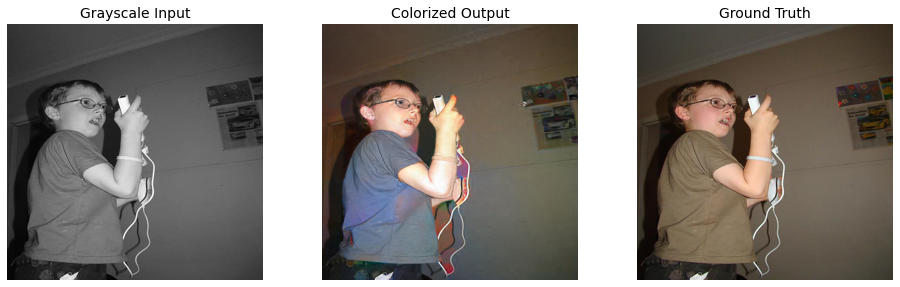

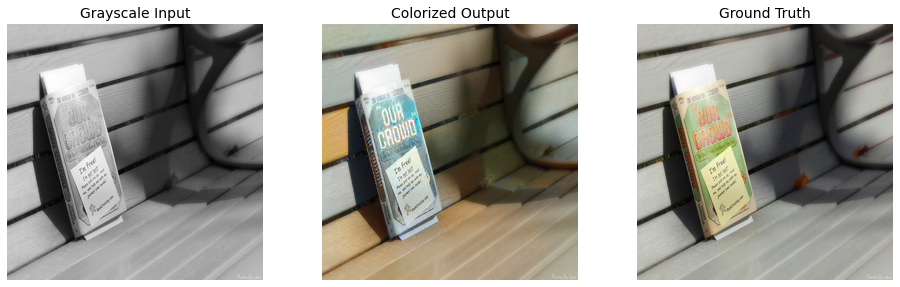

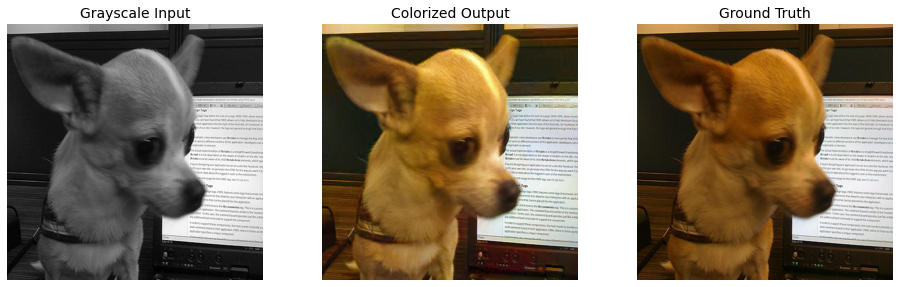

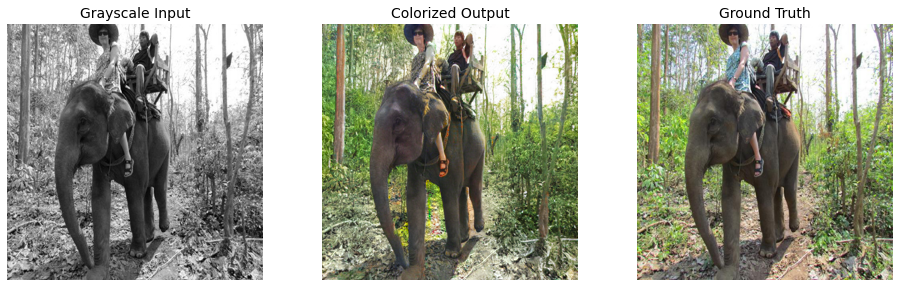

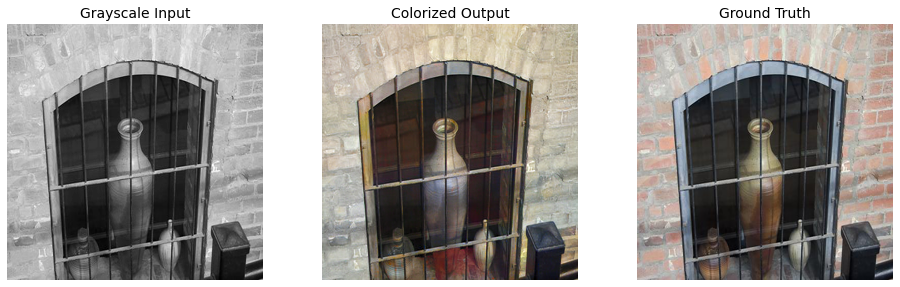

...

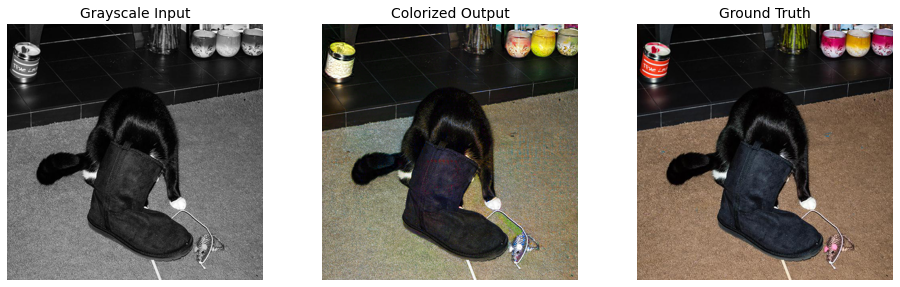

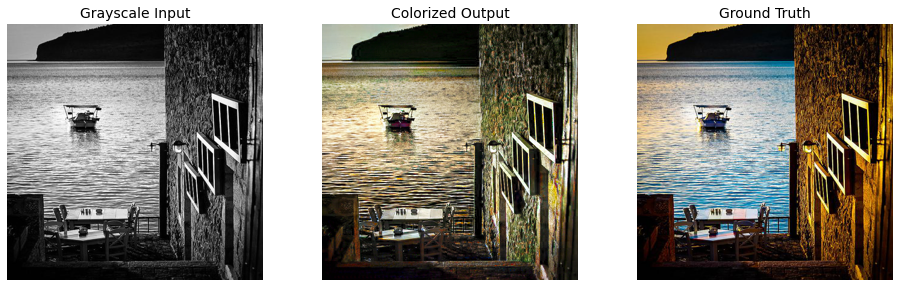

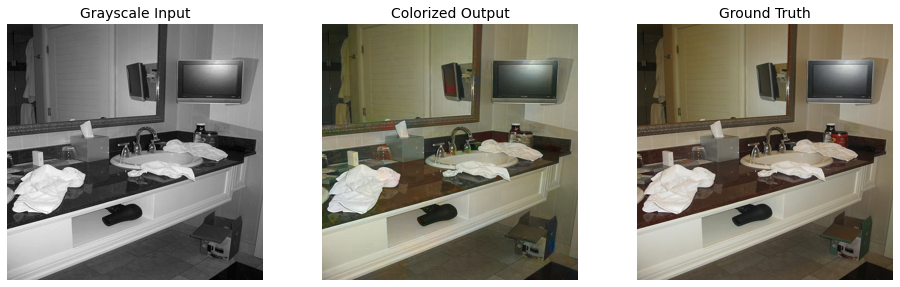

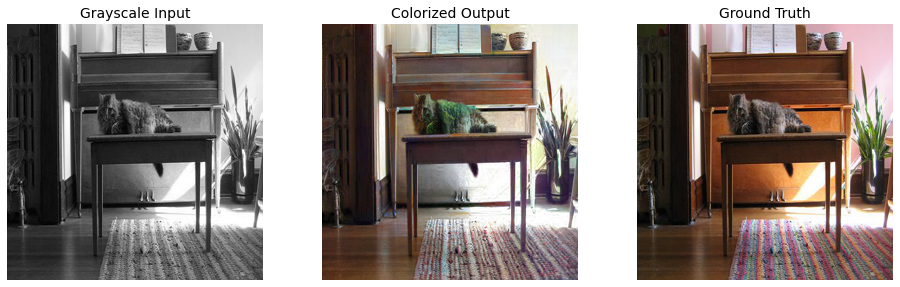

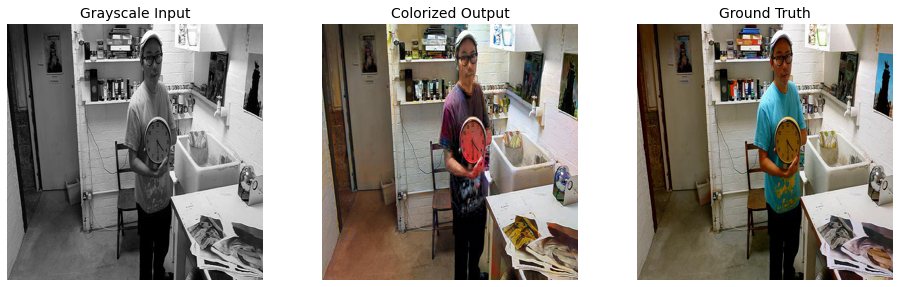

/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


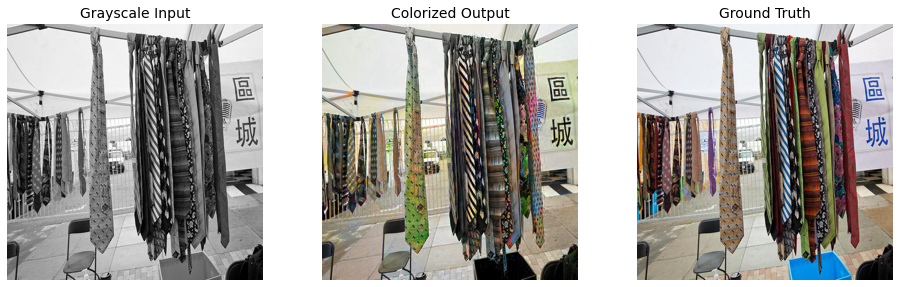

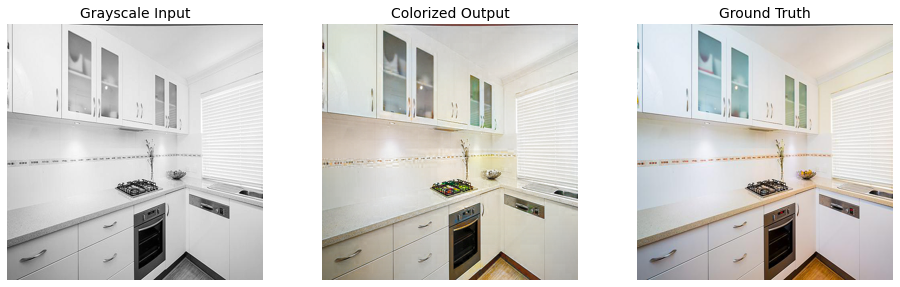

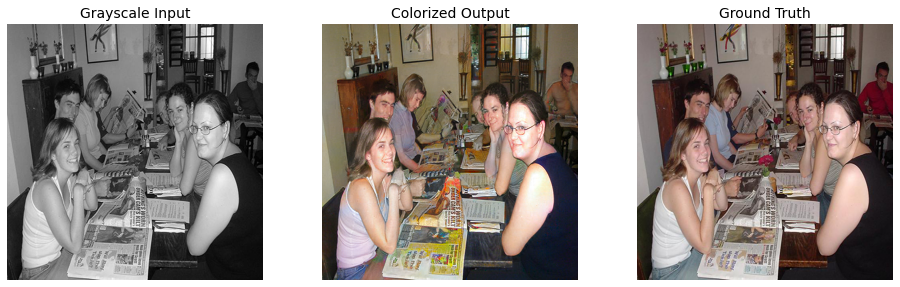

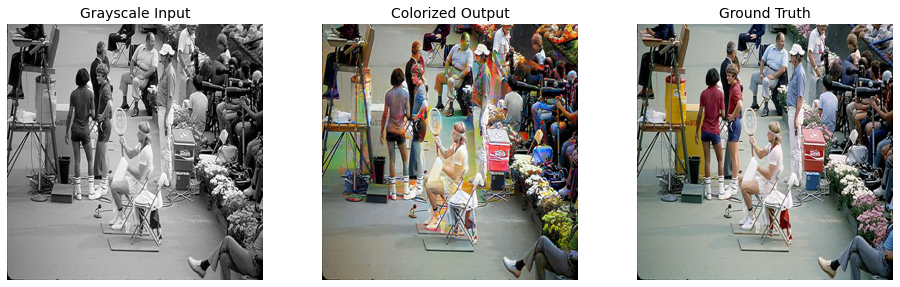

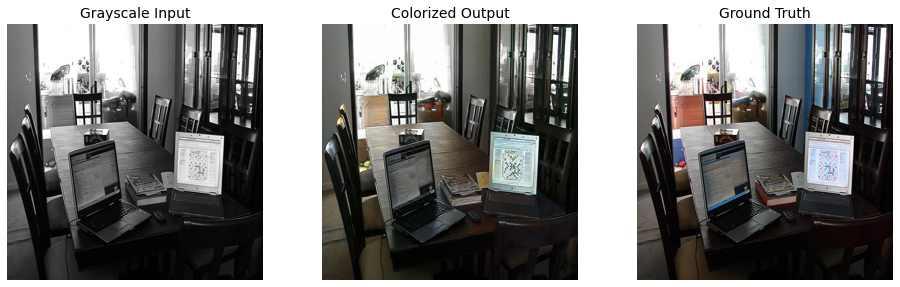

...

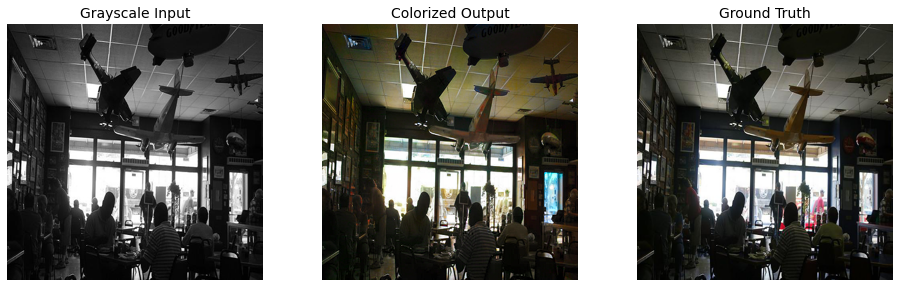

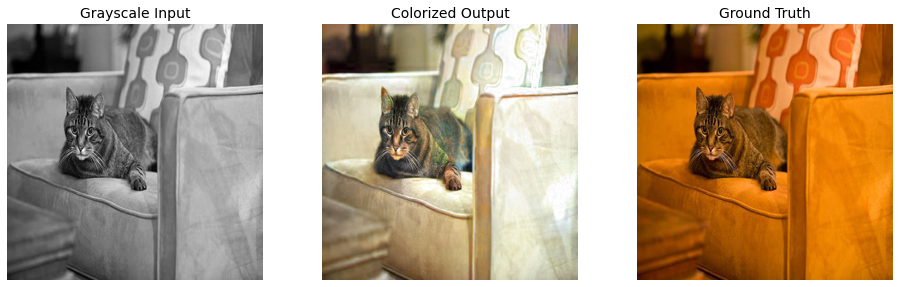

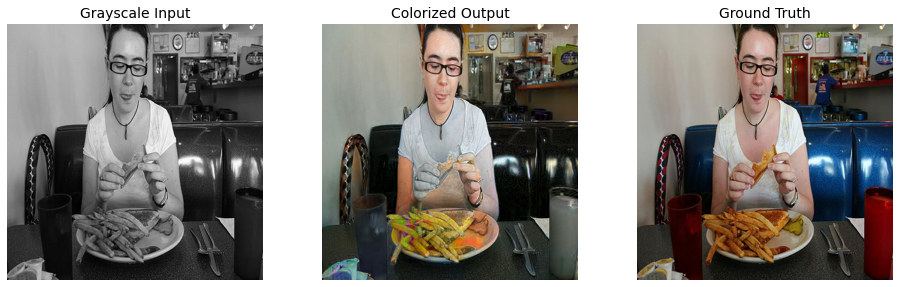

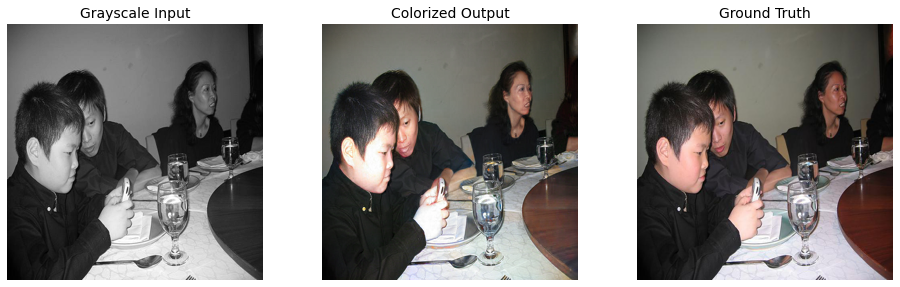

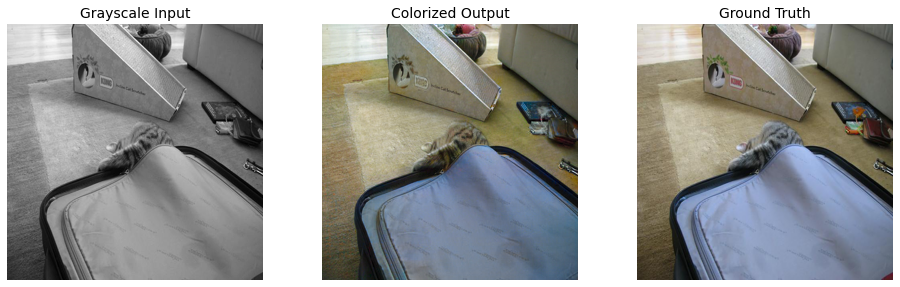

/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


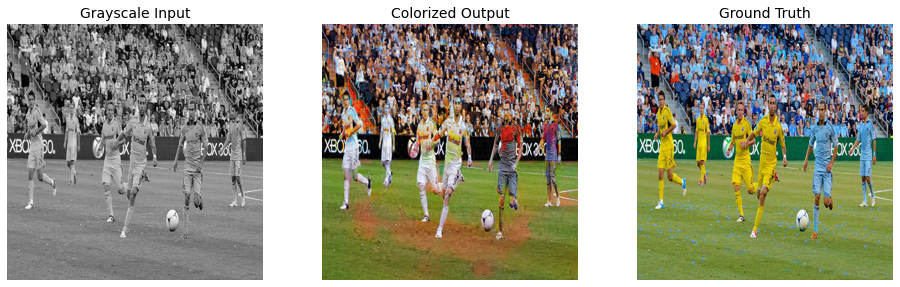

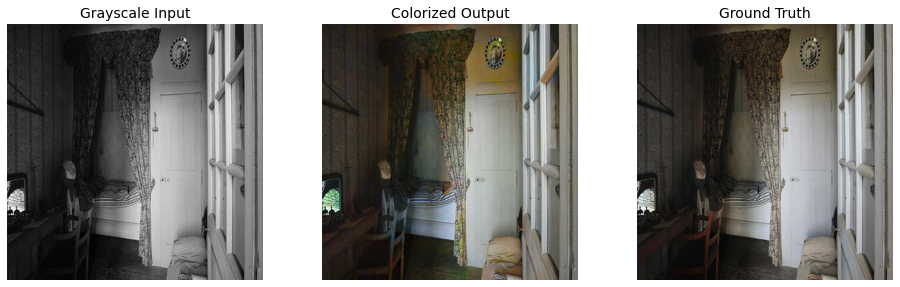

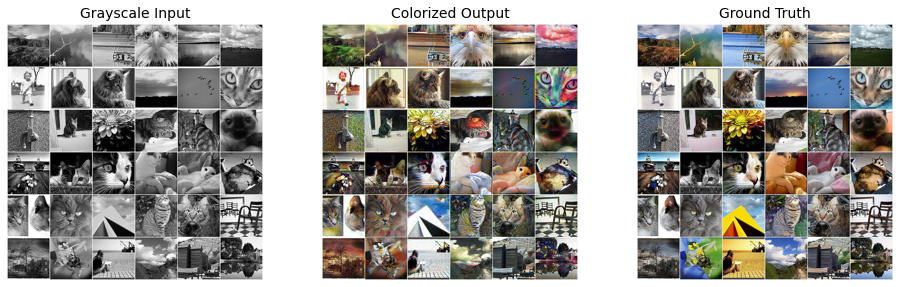

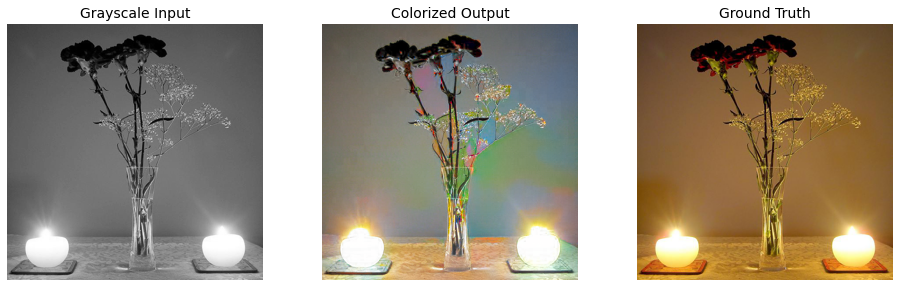

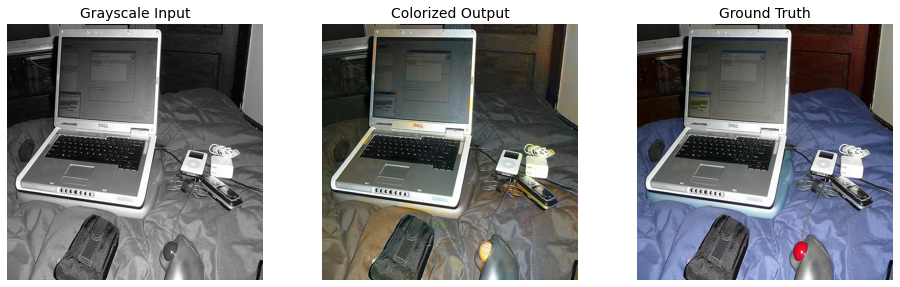

...

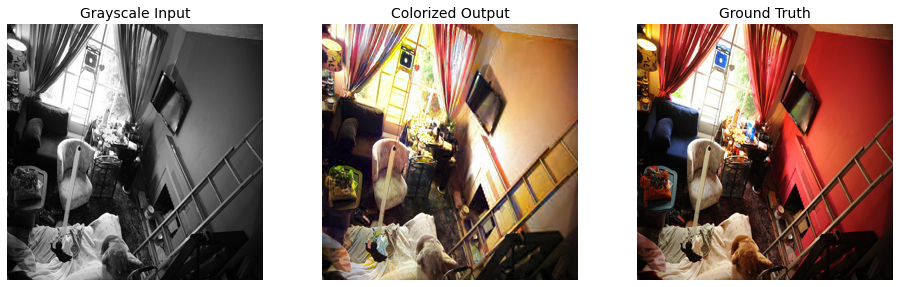

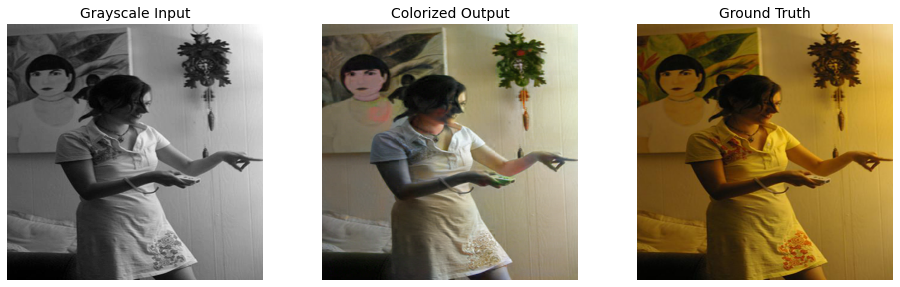

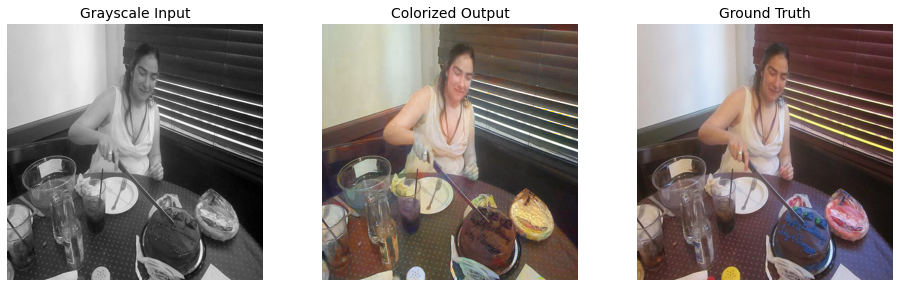

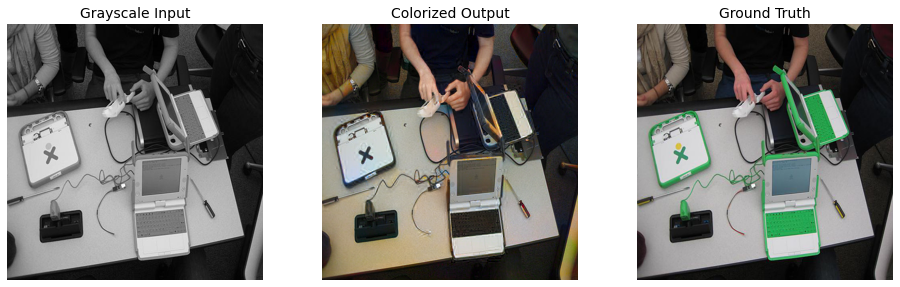

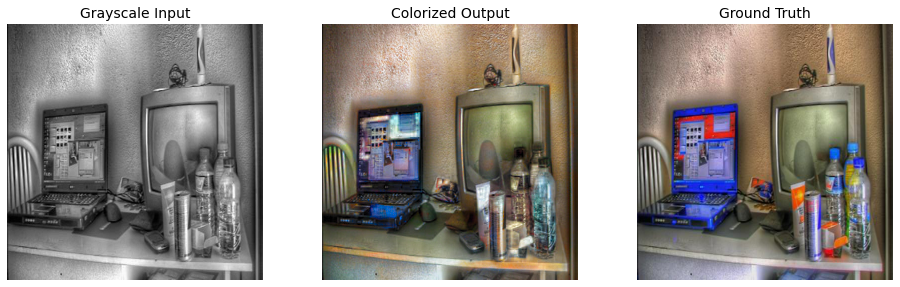

In [ ]:
import PIL
from PIL import Image, ImageMath
import numpy
import cv2
import matplotlib
# from PIL import Image
net_G = build_res_unet (n_input = 1, n_output = 2, size = 256)
net_G.load_state_dict (torch.load ("/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Resnet18_Unet_pretrain/res18_unet_epoch_80.pth", map_location = device))
model = MainModel (net_G = net_G)
# model.load_state_dict (torch.load ("/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/final_model_weights.pth", map_location = device))
# model.load_state_dict (torch.load ("/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Model_Landscape/final_model_weights_20_epochs_land.pth", map_location = device))
model.load_state_dict (torch.load ("/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Model_14 11/model_weights_36_epochs.pth", map_location = device))
for i in range (300,400):
  # image_test = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Data_Test/" + str(i) + ".jpg"
  image_test = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/DaTa_COCO/Validation/coco_val_" + str(i) + ".jpg"
  img = PIL.Image.open(image_test)
  img_or = img.resize((256, 256))
  gray_image = img_or.convert( 'L' )
  
  # to make it between -1 and 1
  img_trans = transforms.ToTensor()(img_or)[:1] * 2. - 1.
  # img_trans = ImageMath.eval("((a/255.0)*2.0)-1.0", a=img_lab)
  model.eval()
  with torch.no_grad():
    preds = model.net_G(img_trans.unsqueeze(0).to(device))
  # plt.imshow(lab_to_rgb(img_trans.unsqueeze(0), preds.cpu())[0])

  plt.figure(figsize=(16,16))
  or_image = plt.subplot(3,3,1)
  or_image.set_title('Grayscale Input', fontsize=14)
  plt.imshow( gray_image , cmap='gray' )
  plt.axis("off")

  in_image = plt.subplot(3,3,2)    
  in_image.set_title('Colorized Output', fontsize=14)
  colorized_image = lab_to_rgb(img_trans.unsqueeze(0), preds.cpu())[0]
  plt.imshow(colorized_image)
  plt.axis("off")

  ou_image = plt.subplot(3,3,3)
  ou_image.set_title('Ground Truth', fontsize=14)
  plt.imshow( img_or)
  plt.axis("off")
  plt.show()

  # Lưu ảnh groud truth
  # image_ground_truth = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Image/Groud_Truth/" + "ground_truth_" + str(i) + ".jpg"
  # im1 = img_or.save("/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Image/Groud_Truth/" + "ground_truth_" + str(i) + ".jpg")
  im1 = img_or.save("/content/drive/MyDrive/Đồ Án Tốt Nghiệp/COCO_Test/Groud_Truth/" + "ground_truth_" + str(i) + ".jpg")
  # Lưu ảnh đã được tô màu
  # image_colorized_output = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Image/Colorized_Output/" + "colorized_ouput_" + str(i) + ".jpg"
  image_colorized_output = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/COCO_Test/Colorized_Output/" + "colorized_ouput_" + str(i) + ".jpg"
  matplotlib.pyplot.imsave(image_colorized_output, colorized_image)



## **6. Đánh giá**

>Đánh giá với các thông số `PSNR`, `MSE`, `SSIM`

>`PSNR` tỉ số tín hiệu cực đại trên nhiễu ( peak signal-to-noise ratio ), thông thường `PSNR` càng cao thì chất lượng dữ liệu được khôi phục càng tốt.

>`MSE` sai số toàn phương trung bình ( Mean squared error ), MSE gần bằng 0 là tốt.

>`SSIM` chỉ số tương đồng cấu trúc ( Structural Similarity Measure ), SSIM gần bằng 1 là giống với ảnh gốc. Sử dụng hàm có sẵn trong Python.

In [ ]:
from skimage.metrics import structural_similarity as ssim
import matplotlib.pyplot as plt
import numpy as np
import cv2
from math import log10, sqrt 
import PIL


In [ ]:
def PSNR(original, compressed):
 mse = np.mean((original - compressed) ** 2)
 if(mse == 0):
  return 100
 max_pixel = 255.0
 psnr = 20 * log10(max_pixel / sqrt(mse))
 return psnr

In [ ]:
def mse(imageA, imageB):
	# the 'Mean Squared Error' between the two images is the
	# sum of the squared difference between the two images;
	# NOTE: the two images must have the same dimension
	err = np.sum((imageA.astype("float") - imageB.astype("float")) ** 2)
	err /= float(imageA.shape[0] * imageA.shape[1])
	
	# return the MSE, the lower the error, the more "similar"
	# the two images are
	return err

In [ ]:
mse_result = []
ssim_result = []
psnr_result = []

for i in range (0,100):
  path_save_ground_truth = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Image/Groud_Truth/" + "ground_truth_" + str(i) + ".jpg"
  path_save_colorized_output = "/content/drive/MyDrive/Đồ Án Tốt Nghiệp/Gan cho tô màu ảnh xám/Image/Colorized_Output/" + "colorized_ouput_" + str(i) + ".jpg"

  ground_truth = cv2.imread(path_save_ground_truth)
  colorized_output = cv2.imread(path_save_colorized_output)

  p = PSNR(ground_truth, colorized_output)
  m = mse(ground_truth, colorized_output)
  s = ssim(ground_truth, colorized_output, multichannel=True)

  # setup the figure

  ground_truth = PIL.Image.open(path_save_ground_truth)
  colorized_output = PIL.Image.open(path_save_colorized_output)
  fig = plt.figure('Ground Truth vs Colorized Output')
  plt.suptitle("%d  -  PSNR: %.3f  -  MSE: %.3f  -  SSIM: %.3f" % (i, p, m, s))
	# show first image
  ax = fig.add_subplot(1, 2, 1)
  plt.imshow(colorized_output)
  plt.axis("off")
	# show the second image
  ax = fig.add_subplot(1, 2, 2)
  plt.imshow(ground_truth)
  plt.axis("off")
	# show the images
  plt.show()
  mse_result.append(m)
  ssim_result.append(s)
  psnr_result.append(p)

In [ ]:
plt.suptitle('PSNR resuult')
plt.plot(psnr_result)

In [ ]:
plt.suptitle('MSE resuult')
plt.plot(mse_result)

In [ ]:
plt.suptitle('SSIM resuult')
plt.plot(ssim_result)